In [26]:
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.engine import DefaultTrainer, default_argument_parser, default_setup, hooks, launch
import cv2
import os

model_name = 'nasfpn_resnest_101_kitti'
# model_name = 'nasfpn_resnest_101_cyclist'

model_dir = '/demo-mount/models'
model_path = os.path.join(model_dir, model_name)
config_dir = '/home/lizhe/cs231n_project/detectron2-ResNeSt/configs/kitti/'
config_file = os.path.join(model_path, 'config.yaml')
# kitti_image_dir = 'datasets/VOC2012/JPEGImages/'
# kitti_test_name = 'datasets/VOC2012/ImageSets/Main/test.txt'

kitti_image_dir = '/home/lizhe/datasets/kitti/testing/image_2/'
kitti_test_name = '/home/lizhe/datasets/kitti/test.txt'

kitti_image_dir = '/demo-mount/datasets/training/prev_2'
kitti_test_name = '/demo-mount/datasets/training/train.txt'

tsinghua_train_image_dir = '/home/lizhe/cs231n_project/detectron2-ResNeSt/datasets/tsinghua_cyclist/VOC2012/JPEGImages/'
tsinghua_image_dir = '/demo-mount/datasets/cyclist/leftImg8bit/valid/tsinghuaDaimlerDataset/'
tsinghua_test_name = 'datasets/tsinghua_cyclist/VOC2012/ImageSets/Main/valid.txt'

def setup():
    """
    Create configs and perform basic setups.
    """
    cfg = get_cfg()
    # add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
    # cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
    # cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
    # cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
    # Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
    # cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    # cfg = get_cfg()
    cfg.merge_from_file(config_file)
    cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, 'model_0029999.pth')
    # cfg.MODEL.WEIGHTS = os.path.join(model_path, 'model_0017999.pth')
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
    return cfg

cfg = setup()
print(model_name)
output_dir = '/home/lizhe/cs231n_project/detectron2-ResNeSt/visualizations/' + model_name

nasfpn_resnest_101_kitti


In [43]:
%%bash -s "$output_dir"
echo $1
mkdir -p $1

/home/lizhe/cs231n_project/detectron2-ResNeSt/visualizations/nasfpn_resnest_101_kitti


In [27]:
from random import sample
from os import path

num_from_kitti = 500
num_from_tsinghua = 0

images_to_read = [
#     'datasets/VOC2012/JPEGImages/000052.png',      # many cars
#     'datasets/VOC2012/JPEGImages/000043.png',      # many ped
#     'datasets/VOC2012/JPEGImages/007318.png',      # many cycle
#     'datasets/VOC2012/JPEGImages/004384.png',      # many cycle
#     tsinghua_train_image_dir + 'tsinghuaDaimlerDataset_2014-11-20_074640_000000290.png', # 2 cyclist + 2 pedestrian
#     tsinghua_train_image_dir + 'tsinghuaDaimlerDataset_2015-03-24_041424_000028621.png', # 2 cyclist
#     tsinghua_train_image_dir + 'tsinghuaDaimlerDataset_2015-03-24_041424_000023311.png', # 2 cyclist
#     tsinghua_train_image_dir + 'tsinghuaDaimlerDataset_2014-12-04_082614_000000654.png', # 2 cyclist + 3 pedestrian
]

prediction_paths = []

def ReadTopKImageNames(image_dir, txt_file, k, random=False):
    paths = []
    with open(txt_file, 'r') as f:
        for line in f.readlines():
            image_name = line.strip()
            if image_dir == tsinghua_image_dir:
                image_name += '_leftImg8bit.png'
            else:
                image_name += '.png'
            paths.append(os.path.join(image_dir, image_name))
    if random:
        return sample(paths, k)
    return paths[:k]

# print(ReadTopKImageNames(kitti_image_dir, kitti_test_name, 5))
# print(ReadTopKImageNames(tsinghua_image_dir, tsinghua_test_name, 5))
images_to_read += ReadTopKImageNames(kitti_image_dir, kitti_test_name, num_from_kitti)[100:]
images_to_read += ReadTopKImageNames(tsinghua_image_dir, tsinghua_test_name, num_from_tsinghua, random=False)

def Predict(im):
    # print("image size : ", im.shape)
    predictor = DefaultPredictor(cfg)
    outputs = predictor(im)
    return outputs

for i in range(len(images_to_read)):
    if i % 3 == 0:
        print(f'saving {i}/{len(images_to_read)}')
    image_name = images_to_read[i].split('/')[-1]
    # print(images_to_read[i])
    if not path.exists(images_to_read[i]):
        print(f'{images_to_read[i]} doesnt exist!')
        continue
    img = cv2.imread(images_to_read[i])
    outputs = Predict(img)
    metadata = MetadataCatalog.get(cfg.DATASETS.TRAIN[0])
    v = Visualizer(img[:, :, ::-1], metadata, scale=1.2)
    # print('output : ', outputs)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    output_path = os.path.join(output_dir, image_name)
    # print(output_path)
    v.save(output_path)

print(f'Saved {len(images_to_read)} images')

Saved 400 images


In [30]:
import collections
from PIL import Image
import numpy as np
from random import sample

images = []
for i in range(len(images_to_read[:100])):
    if i % 10 == 0:
        print(f'reading {i}/{len(images_to_read)}')
    image_name = images_to_read[i].split('/')[-1]
    output_path = os.path.join(output_dir, image_name)
    image = Image.open(output_path)
    images.append(image)
print(f'loaded {len(images)} images')

reading 0/400
reading 10/400
reading 20/400
reading 30/400
reading 40/400
reading 50/400
reading 60/400
reading 70/400
reading 80/400
reading 90/400
loaded 100 images


In [ ]:
sample(images, 1)[0]

/home/lizhe/cs231n_project/detectron2-ResNeSt/visualizations/nasfpn_resnest_101_kittigif_50_80.gif


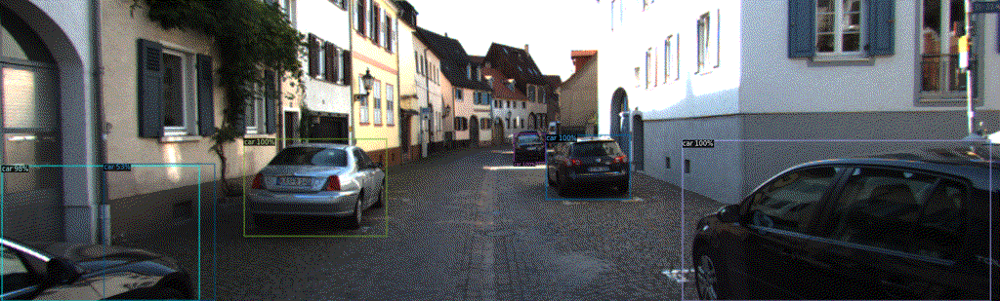

In [31]:
from PIL import Image, ImageDraw

def generate_gif(start, end):
    image_slice = []
    for i in range(start, end):
        image_name = images_to_read[i].split('/')[-1]
        output_path = os.path.join(output_dir, image_name)
        image = Image.open(output_path)
        image.thumbnail((1024, 2048))
        image_slice.append(image.copy())
    gif_path = output_dir + f'gif_{start}_{end}.gif'
    image_slice[0].save(gif_path, save_all=True, append_images=image_slice[1:], optimize=True, duration=400, loop=True)
    return gif_path
gif_path = generate_gif(50,80)
# im = Image.open(gif_path)

from IPython.display import Image
print(gif_path)
Image(filename=gif_path)

In [142]:
sampled_images = sample(images, min(5, len(images)))

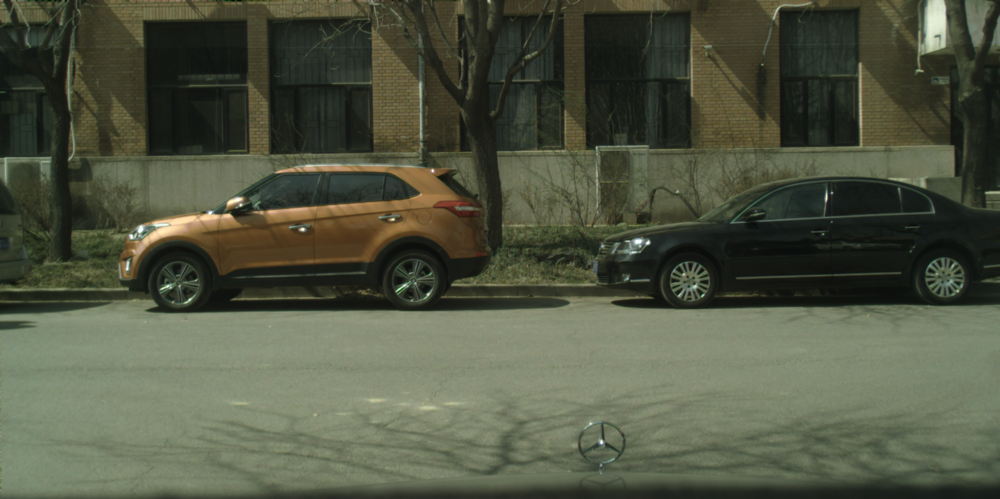

In [143]:
sampled_images[0]

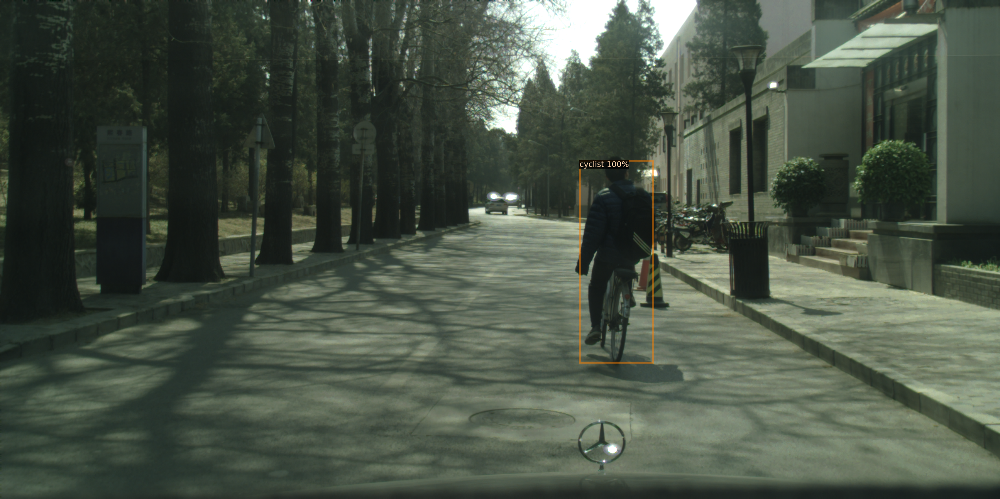

In [144]:
sampled_images[1]

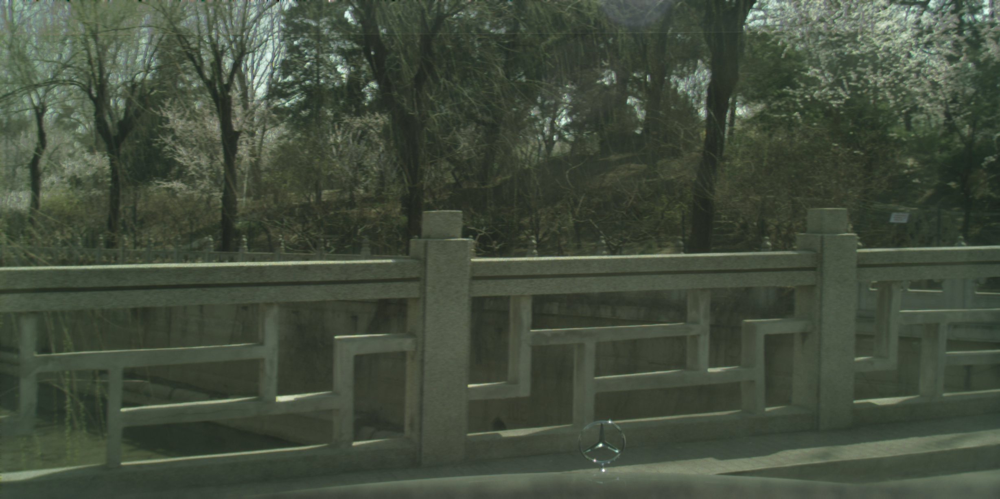

In [145]:
sampled_images[2]

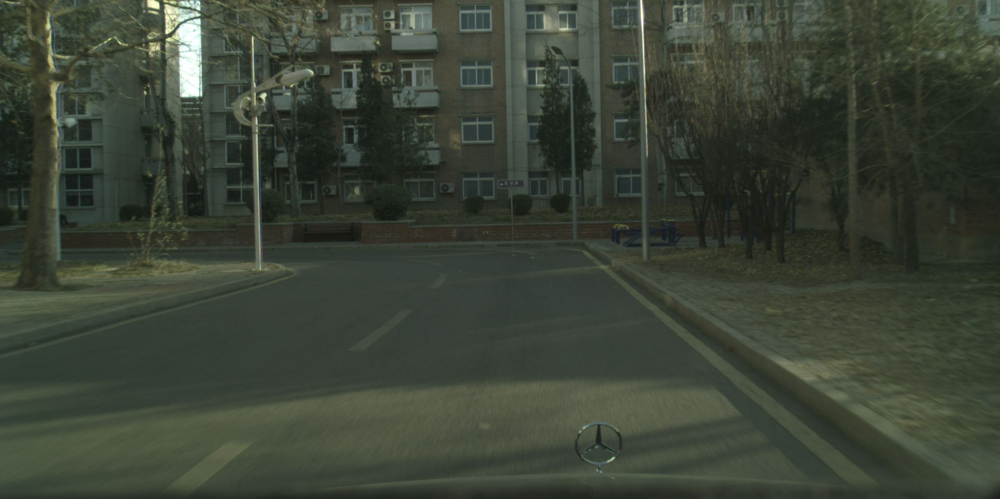

In [146]:
sampled_images[3]

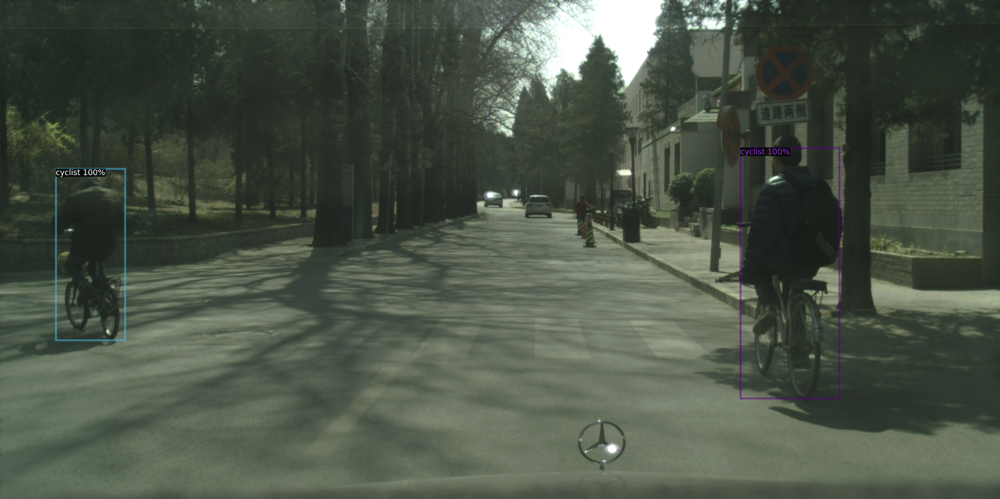

In [147]:
sampled_images[4]